<a href="https://colab.research.google.com/github/mamartinezg/mamartinezg/blob/main/Tarea_3_Hernandez_Martinez.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Ejercicio 4. Clasificacion Breast Cancer#

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# Import matplotlib for graphs, set inline
from matplotlib import pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn import datasets

In [3]:
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()
cancer.keys()
print(cancer.DESCR[27:3130])


Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on the perimeter)
        - texture (standard deviation of gray-scale values)
        - perimeter
        - area
        - smoothness (local variation in radius lengths)
        - compactness (perimeter^2 / area - 1.0)
        - concavity (severity of concave portions of the contour)
        - concave points (number of concave portions of the contour)
        - symmetry
        - fractal dimension ("coastline approximation" - 1)

        The mean, standard error, and "worst" or largest (mean of the three
        worst/largest values) of these features were computed for each image,
        resulting in 30 features.  For instance, field 0 is Mean Radius, field
        10 is Rad

**Creacion del dataframe de Features**

In [4]:
df_features = pd.DataFrame(cancer.data, columns = cancer.feature_names)
df_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

**Creacion del dataframe del target**

In [5]:
cancer.target_names

array(['malignant', 'benign'], dtype='<U9')

In [6]:
df_target = pd.DataFrame(cancer.target, columns=['target'])
df_target['target'].value_counts()

1    357
0    212
Name: target, dtype: int64

#Parte 1. Clasificacion:#

Usar exploracion,visualizacion y Feature importance, para escoger los mejores 5 features de la base de datos para el entrenamiento y ajuste del clasificador.
Con los 5 features escogidos, genere un diagrama de arbol para analizar la relacion entre estos Features
Prepare la base de datos de 5 features y el target. Genere los datos de entrenamiento y test (80-20).
De acuerdo a la exploracion, realize un pipeline donde involucre, normalizacion y preprocesamiento.
Cree estimadores basados en SVM, Logistic Regression, Decision Tree, Neural Nets, Naïve Bayes y knn.
Encuentre el mejor estimador con los mejores parametros.
Reporte los resultados por medio de la matrix de confusion, ROC, F1, precision, recall y accuracy.
Que metrica usted cree que debe usarse para determinar el mejor modelo en este caso de deteccion de cancer?

In [7]:
df_features.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [8]:
df_features.isnull().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
dtype: int64

a columna 'target' no se encuentra en tu DataFrame df_features. unir ambos DataFrames antes de realizar la visualización. Asumiré que tu DataFrame df_target contiene la columna 'target' y comparte un índice común con df_features

In [9]:
df_DataFin = pd.concat([df_features, df_target], axis=1)

In [10]:
df_DataFin.isnull().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
target                     0
dtype: int64

**Exploración**

<Axes: xlabel='mean perimeter', ylabel='target'>

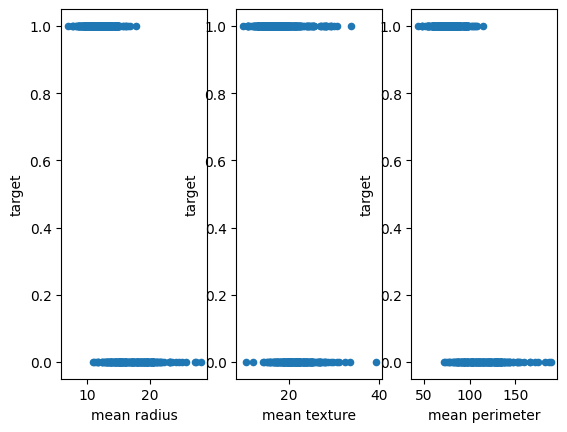

In [ ]:
fig, (ax1,ax2,ax3) =plt.subplots(1,3)
df_DataFin.plot.scatter(x='mean radius',y='target',ax=ax1)
df_DataFin.plot.scatter(x='mean texture',y='target',ax=ax2)
df_DataFin.plot.scatter(x='mean perimeter',y='target',ax=ax3)

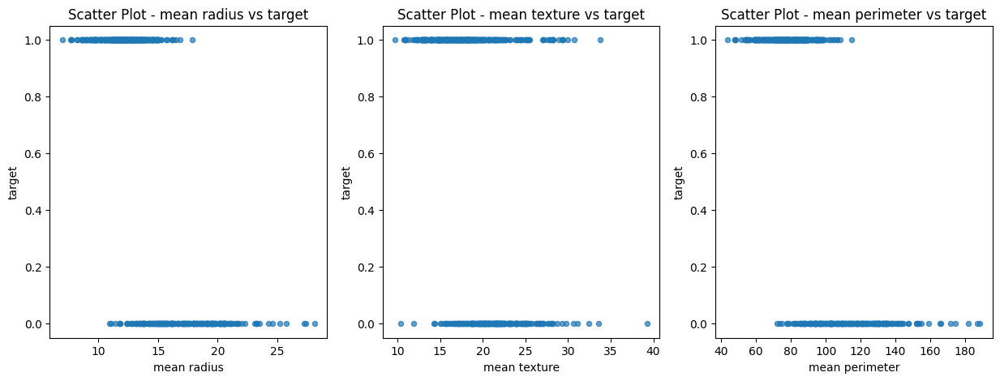

In [ ]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

df_DataFin.plot.scatter(x='mean radius', y='target', ax=ax1, alpha=0.7)
ax1.set_title('Scatter Plot - mean radius vs target')

df_DataFin.plot.scatter(x='mean texture', y='target', ax=ax2, alpha=0.7)
ax2.set_title('Scatter Plot - mean texture vs target')

df_DataFin.plot.scatter(x='mean perimeter', y='target', ax=ax3, alpha=0.7)
ax3.set_title('Scatter Plot - mean perimeter vs target')

plt.show()

Feature importance para cada atributo, de la siguiente manera:

In [ ]:
# Calcula la matriz de correlación
correlation_matrix = df_DataFin.corr()
correlation_matrix.head()


,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
mean radius,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,-0.311631,...,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066,-0.730029
mean texture,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,-0.076437,...,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205,-0.415185
mean perimeter,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,-0.261477,...,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019,-0.742636
mean area,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,-0.283110,...,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738,-0.708984
mean smoothness,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,0.584792,...,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316,-0.358560


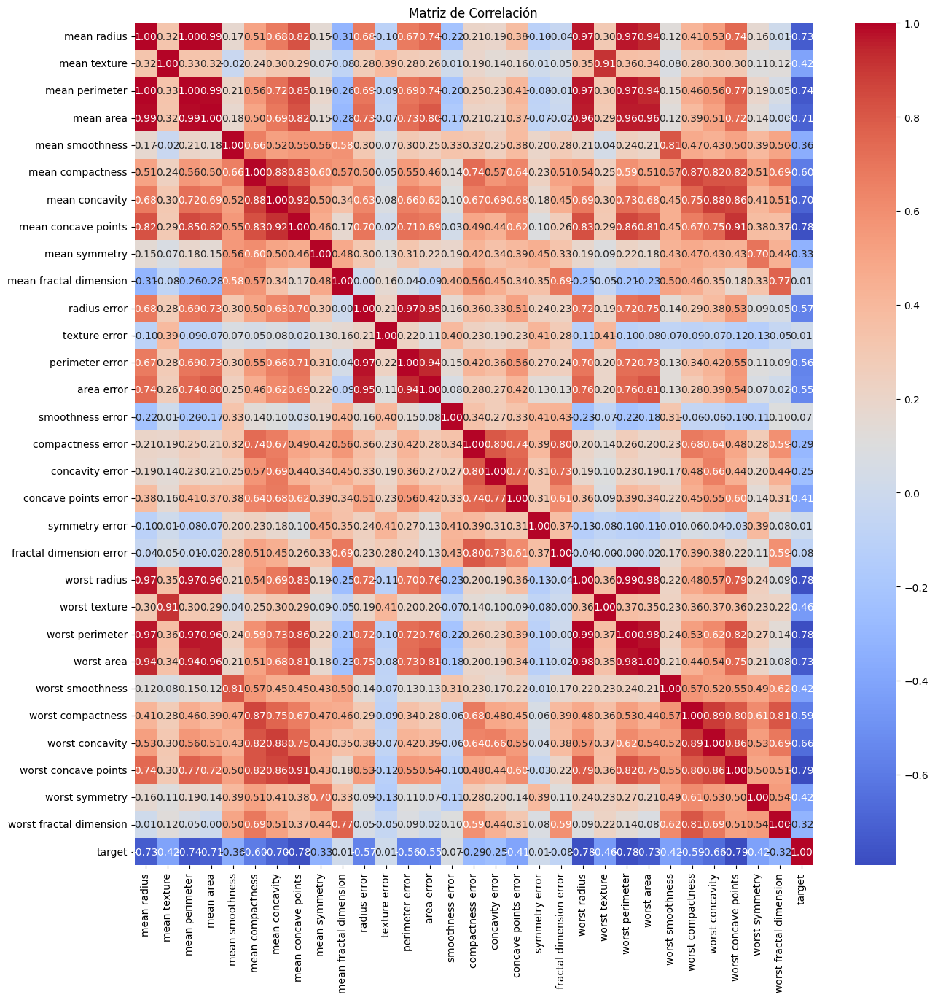

In [ ]:
# Visualiza la matriz de correlación con un mapa de calor
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlación')
plt.show()

In [ ]:
g= sns.pairplot(df_DataFin, hue='target',kind="scatter")

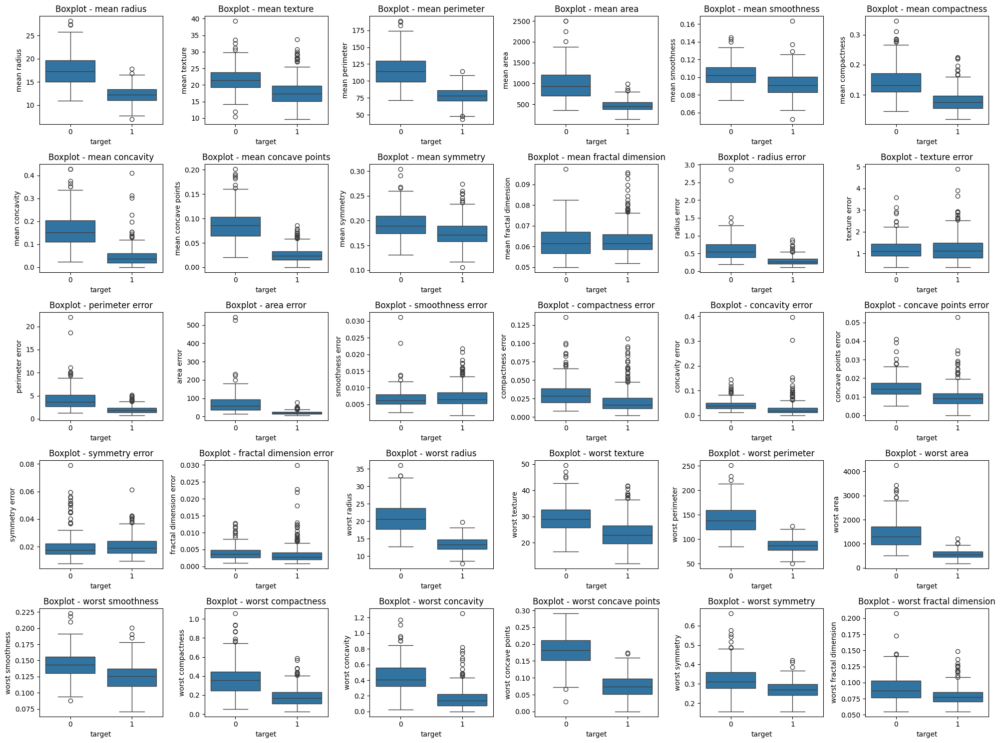

In [ ]:
# Visualiza gráficos de caja para cada feature en función de la variable objetivo
plt.figure(figsize=(20, 15))
for i, feature in enumerate(df_features.columns):
    plt.subplot(5, 6, i+1)
    sns.boxplot(x='target', y=feature, data=df_DataFin)
    plt.title(f'Boxplot - {feature}')
plt.tight_layout()
plt.show()

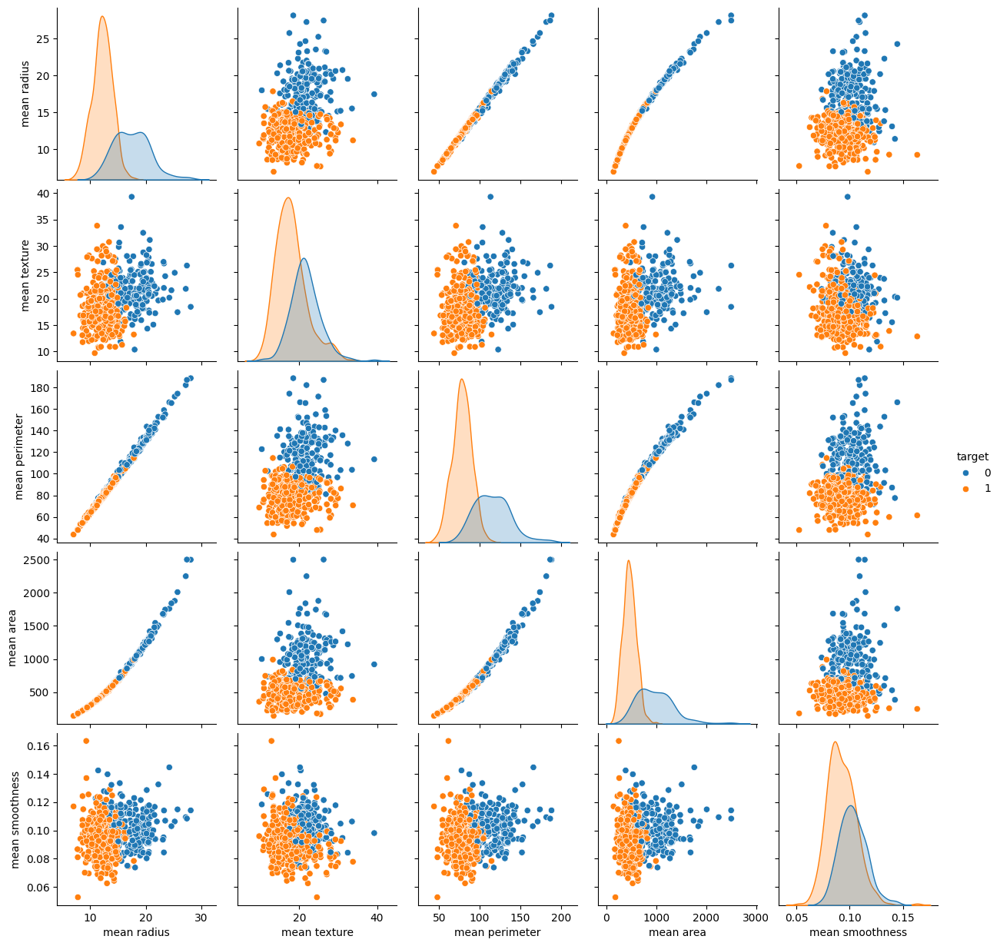

In [ ]:
# Análisis exploratorio y visualización
sns.pairplot(df_DataFin, hue='target', vars=['mean radius', 'mean texture', 'mean perimeter', 'mean area', 'mean smoothness'])
plt.show()



#Análisis de Importancia de Características:#
Utiliza modelos de clasificación para calcular la importancia de las características.

In [11]:
from sklearn.ensemble import RandomForestClassifier

# Crea un modelo de clasificación (por ejemplo, Random Forest)
model = RandomForestClassifier(random_state=42)

# Ajusta el modelo
model.fit(df_features, df_target['target'])


RandomForestClassifier(random_state=42)

In [12]:
# Extrae la importancia de las características
feature_importance = model.feature_importances_

# Crea un DataFrame con la importancia de las características
df_importance = pd.DataFrame({'Feature': df_features.columns, 'Importance': feature_importance})


In [13]:
# Ordena el DataFrame por importancia
df_importance = df_importance.sort_values(by='Importance', ascending=False)

<ipython-input-13-08c57ecac7d9>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=df_importance, palette='viridis')


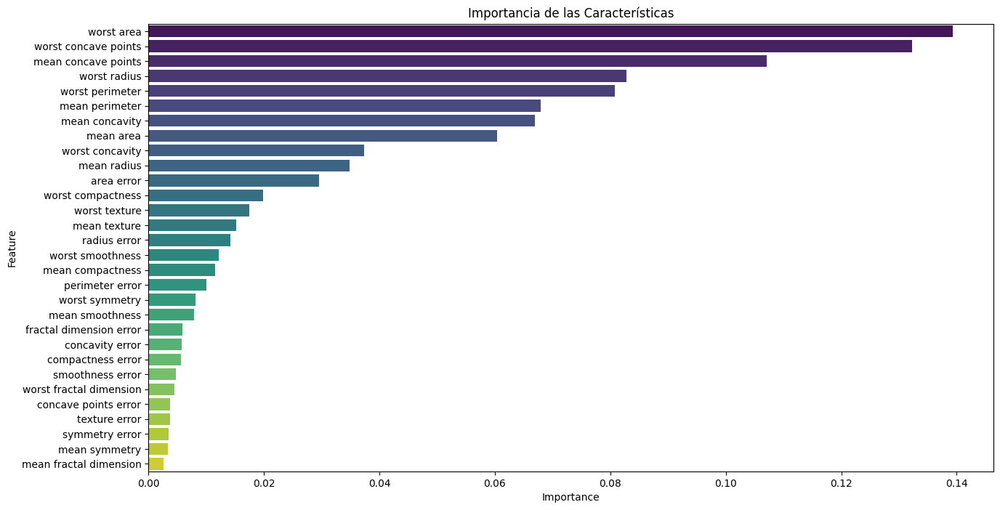

In [13]:
# Visualiza la importancia de las características
plt.figure(figsize=(15, 8))
sns.barplot(x='Importance', y='Feature', data=df_importance, palette='viridis')
plt.title('Importancia de las Características')
plt.show()

In [14]:
top_5_features = model.feature_importances_.argsort()[-5:][::-1]
print(df_features.columns[top_5_features].tolist())

['worst area', 'worst concave points', 'mean concave points', 'worst radius', 'worst perimeter']


#

In [15]:
from sklearn.tree import DecisionTreeClassifier, export_text
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer

In [16]:
# División de datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(df_features, df_target['target'], test_size=0.2, random_state=42)

In [17]:
# Definir las columnas numéricas y categóricas
numeric_features = df_features.select_dtypes(include=['float64']).columns
categorical_features = df_features.select_dtypes(include=['object']).columns


In [18]:
# Crear preprocesador
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(), categorical_features)
    ])

In [19]:
# Crear el pipeline con el preprocesador y el clasificador de árbol de decisión
pipeline_tree = Pipeline(
    steps=[
        ("preprocessing", preprocessor),
        ('tree', DecisionTreeClassifier(criterion='entropy'))
    ])

In [20]:
# Entrenar el modelo
model_tree = pipeline_tree.fit(X_train, y_train)

In [21]:
# Obtener importancias de características
importances = model_tree['tree'].feature_importances_
col_importances = pd.Series(importances, index=df_features.columns)

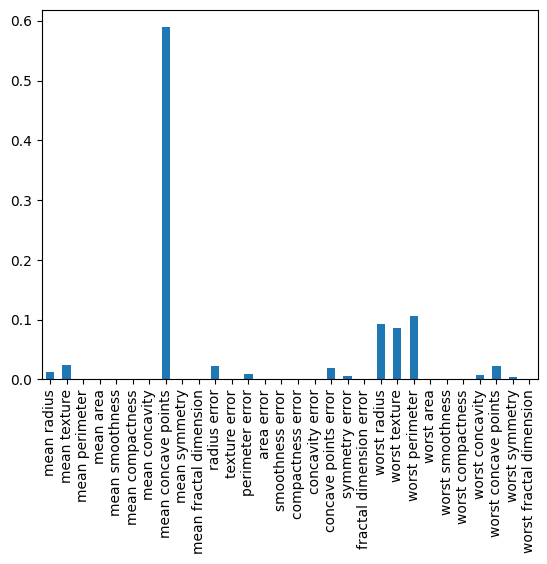

In [22]:
# Visualizar importancias de características
fig, ax = plt.subplots()
col_importances.plot.bar(ax=ax)
plt.show()

De acuerdo a lo anterior tenemos las 5 features de la base de datos para el entrenamiento y ajuste del clasificador.

In [23]:
top_5_features_tree = col_importances.argsort()[-5:][::-1]
print(df_features.columns[top_5_features_tree].tolist())

['mean concave points', 'worst perimeter', 'worst radius', 'worst texture', 'mean texture']


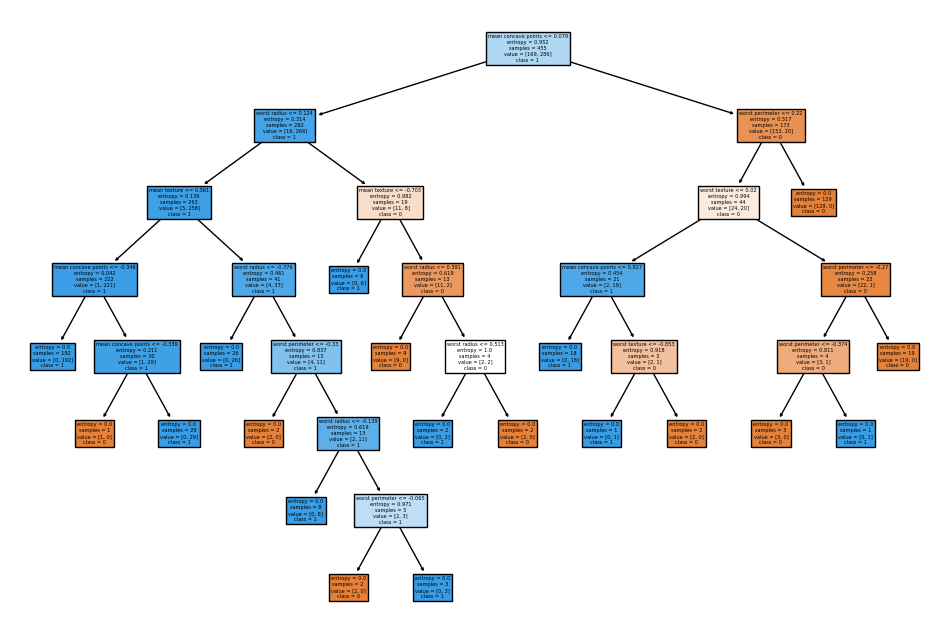

In [28]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Visualizar el árbol de decisión usando plot_tree
plt.figure(figsize=(12, 8))
plot_tree(model_tree_selected['tree'], feature_names=selected_features, class_names=['0', '1'], filled=True)
plt.show()

In [29]:
# Obtener los datos de entrada solo con las características seleccionadas
X_selected = df_features[selected_features]

# División de datos en conjunto de entrenamiento y prueba(80-20)
X_train_selected, X_test_selected, y_train_selected, y_test_selected = train_test_split(
    X_selected, df_target['target'], test_size=0.2, random_state=42
)

In [32]:
# Definir las columnas numéricas y categóricas de las características seleccionadas
numeric_features_selected = X_selected.select_dtypes(include=['float64']).columns
categorical_features_selected = X_selected.select_dtypes(include=['object']).columns


In [33]:
# Crear preprocesador para las características seleccionadas
preprocessor_selected = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features_selected),
        ('cat', OneHotEncoder(), categorical_features_selected)
    ])


In [34]:
# Crear el pipeline con el preprocesador y el clasificador de árbol de decisión
pipeline_selected = Pipeline(
    steps=[
        ("preprocessing", preprocessor_selected),
        ('tree', DecisionTreeClassifier(criterion='entropy'))
    ])

# Entrenar el modelo solo con las características seleccionadas
model_selected = pipeline_selected.fit(X_train_selected, y_train_selected)

In [35]:
model_selected

Pipeline(steps=[('preprocessing',
                 ColumnTransformer(transformers=[('num', StandardScaler(),
                                                  Index(['mean concave points', 'worst perimeter', 'worst radius',
       'worst texture', 'mean texture'],
      dtype='object')),
                                                 ('cat', OneHotEncoder(),
                                                  Index([], dtype='object'))])),
                ('tree', DecisionTreeClassifier(criterion='entropy'))])

In [37]:
from sklearn import svm
from sklearn.model_selection import GridSearchCV

In [38]:
pipelinesvm = Pipeline(
    steps=[
     ("preprocessing", preprocessor_selected),
     ('svm', svm.SVC())
    ]
)

parasmsvm= [
    {
       "svm__C":[0.9,0.1,0.8,1.1],
       "svm__kernel":["linear", "poly", "rbf"]
    }
]

gs_svm = GridSearchCV(estimator=pipelinesvm,param_grid=parasmsvm,cv=10,scoring="accuracy")

In [39]:
gs_svm


GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessing',
                                        ColumnTransformer(transformers=[('num',
                                                                         StandardScaler(),
                                                                         Index(['mean concave points', 'worst perimeter', 'worst radius',
       'worst texture', 'mean texture'],
      dtype='object')),
                                                                        ('cat',
                                                                         OneHotEncoder(),
                                                                         Index([], dtype='object'))])),
                                       ('svm', SVC())]),
             param_grid=[{'svm__C': [0.9, 0.1, 0.8, 1.1],
                          'svm__kernel': ['linear', 'poly', 'rbf']}],
             scoring='accuracy')

In [40]:
modelsvm = gs_svm.fit(X_train,y_train)

In [41]:
print(modelsvm.best_params_,modelsvm.best_score_,modelsvm.score(X_test,y_test))

{'svm__C': 0.9, 'svm__kernel': 'linear'} 0.9670048309178745 0.9649122807017544


In [42]:
predictSVM= modelsvm.predict(X_test)

In [46]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Suponiendo que modelsvm es tu modelo SVM
y_pred = modelsvm.predict(X_test)

# Crear la matriz de confusión
cm = confusion_matrix(y_test, y_pred)


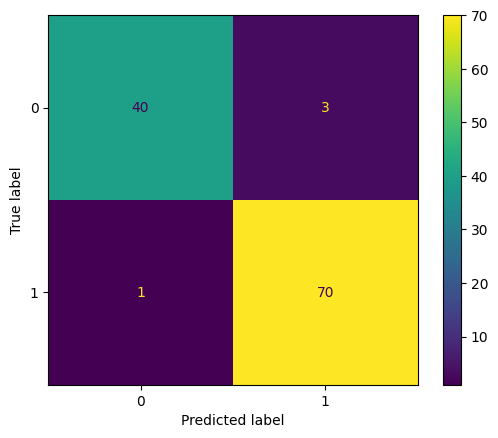

In [45]:

# Mostrar la matriz de confusión
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelsvm.classes_)
disp.plot()

In [48]:
from sklearn.metrics import classification_report

# Suponiendo que predictSVM contiene las predicciones de tu modelo SVM
print(classification_report(y_test, predictSVM))


              precision    recall  f1-score   support

           0       0.98      0.93      0.95        43
           1       0.96      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114

